In [ ]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tiff
from scipy.ndimage import generic_filter

# --- Settings ---
folder_path = "../data/processed/sentinel1"
tiff_files = [f for f in os.listdir(folder_path) if f.endswith(".tiff")]

# Select a random Sentinel-1 image
random_file = random.choice(tiff_files)
image_path = os.path.join(folder_path, random_file)
print(f"Selected Sentinel-1 file: {random_file}")

# Extract patch_id prefix (e.g. patch_00032_5925311e)
patch_id = "_".join(random_file.split("_")[:2])

# Load Sentinel-1 image
image = tiff.imread(image_path)
if image.ndim == 3 and image.shape[0] == 1:
    image = image[0]

# Convert to dB
image_db = 10 * np.log10(image + 1e-6)

# Raw masks
# water_mask = image_db < -17
# builtup_mask = image_db > -8
# vegetation_mask = (image_db > -15) & (image_db < -10)

# --- Generate masks ---
local_std = generic_filter(image_db, np.std, size=5)
water_mask = (image_db < -12) #& (local_std < 0.7)
builtup_mask = (image_db > -8) & (local_std > 0.7)
vegetation_mask = ((image_db > -16) & (image_db < -8)) & (local_std > 0.3)

# Slope estimation: local std
local_std = generic_filter(image_db, np.std, size=5)
slope_mask = local_std > 2.5

# Normalize VV
def normalize(img):
    return (img - np.min(img)) / (np.max(img) - np.min(img))
vv_norm = normalize(image)

# Composite RGB with overlays
rgb = np.stack([vv_norm, vv_norm, vv_norm], axis=-1)
rgb[water_mask] = [0.0, 0.5, 1.0]
rgb[builtup_mask] = [1.0, 0.3, 0.3]

# --- Load Sentinel-2 processed RGB image ---
s2_folder = "../data/processed/sentinel2"
s2_candidates = [f for f in os.listdir(s2_folder) if f.startswith(patch_id) and f.endswith(".tiff")]

if s2_candidates:
    s2_file = os.path.join(s2_folder, s2_candidates[0])
    print(f"Matched Sentinel-2 file: {s2_candidates[0]}")
    s2_image = tiff.imread(s2_file)

    if s2_image.ndim == 3 and s2_image.shape[0] >= 4:
        s2_transposed = np.transpose(s2_image, (1, 2, 0))  # (bands, H, W) → (H, W, bands)
        s2_rgb = s2_transposed[:, :, [3, 2, 1]]  # Bands B04, B03, B02 → RGB
        # s2_rgb = np.clip(s2_rgb / 3000, 0, 1)  # normalize for display
    else:
        s2_rgb = np.ones((*image.shape, 3)) * 0.5  # fallback gray
        print("⚠️ Sentinel-2 image shape unexpected.")
else:
    s2_rgb = np.ones((*image.shape, 3)) * 0.5
    print("⚠️ No matching Sentinel-2 image found.")

# --- Plot in 3×3 grid ---
fig, axs = plt.subplots(3, 3, figsize=(10, 10))
axs = axs.flatten()

titles = [
    "VV Linear (Raw)",
    "Backscatter (dB)",
    "Water Mask",
    "Built-up Mask",
    "Composite Image",
    "Vegetation Mask",
    "Slope Mask",
    "Sentinel-2 RGB",
    ""  # Empty slot
]

images = [
    vv_norm,
    image_db,
    water_mask,
    builtup_mask,
    rgb,
    vegetation_mask,
    slope_mask,
    s2_rgb,
    np.ones_like(vv_norm) * np.nan
]

cmaps = [
    "gray",
    "gray",
    "Blues",
    "Reds",
    None,
    "Greens",
    "cividis",
    None,
    "gray"
]

for i in range(9):
    if i in [4, 7]:  # RGB images
        axs[i].imshow(images[i])
    elif i == 8:
        axs[i].axis("off")
        axs[i].set_title(titles[i])
        continue
    else:
        axs[i].imshow(images[i], cmap=cmaps[i])
    axs[i].set_title(titles[i])
    axs[i].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import os
import json
import numpy as np
import matplotlib.pyplot as plt
import tifffile as tiff
from datetime import datetime
from scipy.ndimage import generic_filter, binary_opening, binary_closing

# --- Config ---
dpi = 80
alpha = 0.4

for _ in range(4):
    # --- Select random Sentinel-1 image ---
    s1_folder = "../data/processed/sentinel1"
    s1_files = [f for f in os.listdir(s1_folder) if f.endswith(".tiff")]
    random_file = np.random.choice(s1_files)
    s1_path = os.path.join(s1_folder, random_file)
    print(f"Selected Sentinel-1 image: {random_file}")

    # Extract patch_id and date
    parts = random_file.split("_")
    patch_id = "_".join(parts[:2])
    if len(parts) >= 4 and parts[3][:8].isdigit():
        sentinel1_date = datetime.strptime(parts[3][:8], "%Y%m%d")
    else:
        raise ValueError(f"Could not extract date from filename: {random_file}")

    # Load Sentinel-1 image
    image = tiff.imread(s1_path)
    if image.ndim == 3 and image.shape[0] == 1:
        image = image[0]
    image_db = 10 * np.log10(image + 1e-6)

    # --- Generate masks ---
    local_std = generic_filter(image_db, np.std, size=5)
    water_mask = (image_db < -12) #& (local_std < 0.7)
    builtup_mask = (image_db > -8) & (local_std > 0.7)
    vegetation_mask = ((image_db > -16) & (image_db < -8)) & (local_std > 0.3)

    # --- Find closest usable Sentinel-2 image ---
    s2_folder = "../data/processed/sentinel2"
    json_candidates = [f for f in os.listdir(s2_folder) if f.startswith(patch_id) and f.endswith(".json")]

    date_file_pairs = []
    for json_file in json_candidates:
        json_path = os.path.join(s2_folder, json_file)
        try:
            with open(json_path, "r") as f:
                meta = json.load(f)
                timestamp = meta.get("timestamp", "")
                if timestamp:
                    s2_date = datetime.strptime(timestamp[:10], "%Y-%m-%d")
                    delta = abs((sentinel1_date - s2_date).days)
                    base_name = os.path.splitext(json_file)[0]
                    date_file_pairs.append((delta, base_name))
        except Exception as e:
            print(f"⚠️ Failed reading {json_path}: {e}")

    date_file_pairs.sort(key=lambda x: x[0])

    s2_rgb = None
    min_days_diff = None

    for delta, base_name in date_file_pairs:
        s2_file = os.path.join(s2_folder, base_name + ".tiff")
        if not os.path.exists(s2_file):
            continue
        try:
            s2_image = tiff.imread(s2_file)
            if s2_image.ndim == 3 and s2_image.shape[0] >= 4:
                s2_transposed = np.transpose(s2_image, (1, 2, 0))
                s2_rgb_temp = s2_transposed[:, :, [3, 2, 1]]

                black_mask = np.all(s2_rgb_temp < 0.05, axis=-1)     # strict dark
                white_mask = np.any(s2_rgb_temp > 0.95, axis=-1)     # any channel very bright

                black_ratio = np.mean(black_mask)
                white_ratio = np.mean(white_mask)

                print(f"🔍 Checking {base_name}: Δ={delta} days | black={black_ratio:.2%}, white={white_ratio:.2%}")

                if black_ratio <= 0.1 and white_ratio <= 0.1:
                    s2_rgb = s2_rgb_temp
                    min_days_diff = delta
                    print("✅ Accepted")
                    break
                else:
                    print("❌ Skipped due to threshold limits")
        except Exception as e:
            print(f"⚠️ Could not read image {s2_file}: {e}")


    if s2_rgb is None:
        print("❌ No valid Sentinel-2 image found — fallback gray")
        s2_rgb = np.ones((*image.shape, 3)) * 0.5

    # --- Helper to generate RGBA overlays ---
    def create_overlay(w_mask, v_mask, b_mask, alpha=0.3):
        overlay = np.zeros((*w_mask.shape, 4), dtype=np.float32)
        overlay[w_mask] = [0.0, 0.5, 1.0, alpha]
        overlay[v_mask] = [0.0, 1.0, 0.0, alpha]
        overlay[b_mask] = [1.0, 0.2, 0.2, alpha]
        return overlay

    # --- Overlays ---
    overlay_raw_2 = create_overlay(water_mask, vegetation_mask, builtup_mask, alpha=0.8)
    overlay_raw = create_overlay(water_mask, vegetation_mask, builtup_mask, alpha=alpha)

    # --- Plot 1x3 Grid ---
    height, width = s2_rgb.shape[:2]
    figsize = (3 * width * 0.5 / dpi, height * 0.5 / dpi)
    fig, axs = plt.subplots(1, 3, figsize=figsize, dpi=dpi)

    # 1. Raw Sentinel-2
    axs[0].imshow(s2_rgb)
    axs[0].axis("off")
    axs[0].set_title("Raw Sentinel-2 RGB", fontsize=14, loc='left')

    # 2. Sentinel-2 + Original Mask
    axs[1].imshow(s2_rgb)
    axs[1].imshow(overlay_raw)
    axs[1].axis("off")
    axs[1].set_title(f"With Original Mask (Δ {min_days_diff} days)", fontsize=14, loc='left')

    # 3. Mask Only (no background)
    blank = np.ones_like(s2_rgb)
    axs[2].imshow(blank)
    axs[2].imshow(overlay_raw_2)
    axs[2].axis("off")
    axs[2].set_title("Original Mask Only", fontsize=14, loc='left')

    plt.tight_layout()
    plt.show()




🌍 Collecting valid pixels for global percentile calculation...

✅ Global normalization values: p2=106.0, p98=1466.0

🖼 Generating globally normalized RGB tiles (with fallback to alternate dates)...
🚫 patch_00032_5925311e (patch_00032_5925311e_20180602T024012.629000+0000_res1024.tiff) white pixels: 14.82%
🚫 patch_00032_5925311e (patch_00032_5925311e_20180607T024015.785000+0000_res1024.tiff) white pixels: 5.30%
✅ patch_00032_5925311e (patch_00032_5925311e_20180617T024015.131000+0000_res1024.tiff)
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20180602T024012.629000+0000_res1024.tiff) white pixels: 5.57%
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20180605T025008.291000+0000_res1024.tiff) black pixels: 97.92%
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20180607T024015.785000+0000_res1024.tiff) white pixels: 23.22%
✅ patch_00033_4e36ed13 (patch_00033_4e36ed13_20180617T024015.131000+0000_res1024.tiff)
✅ patch_00034_1558c231 (patch_00034_1558c231_20180602T024012.629000+0000_res1024.tiff)
🚫 

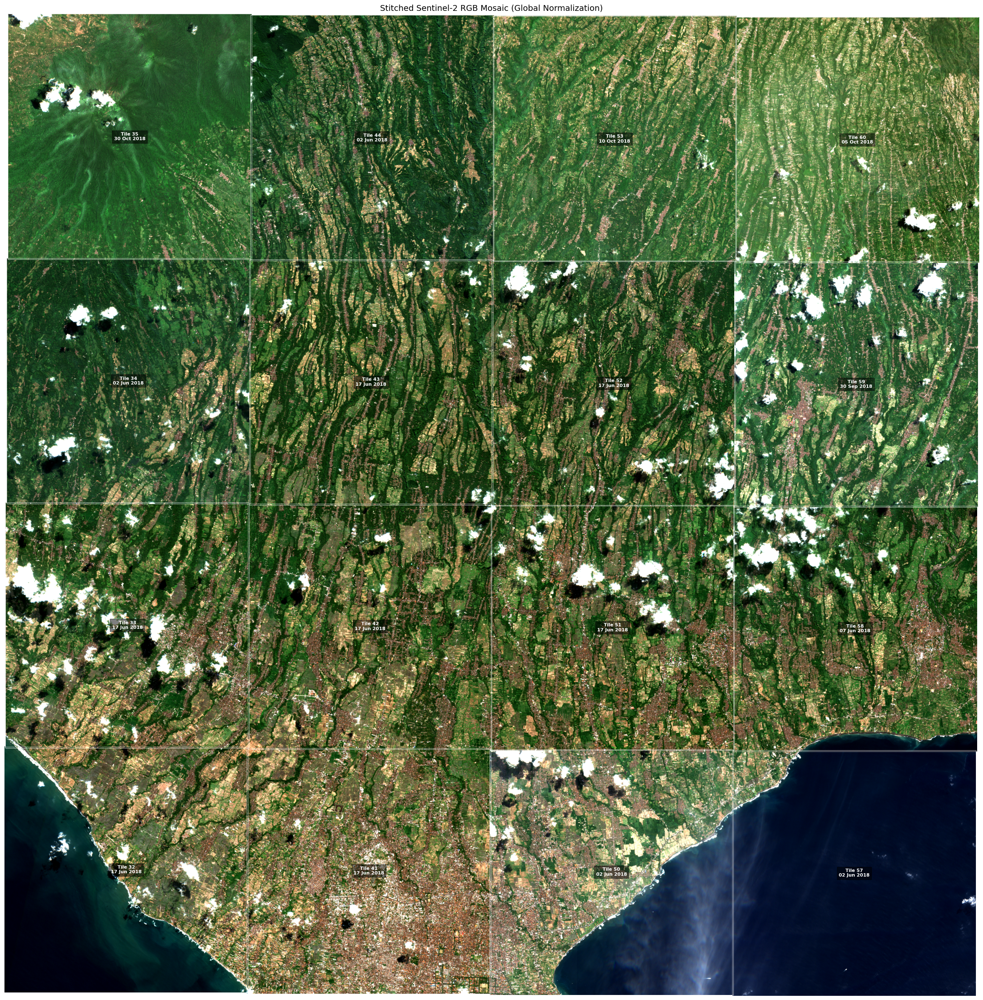

In [70]:
import os
import re
import numpy as np
import geopandas as gpd
from tifffile import imread
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from datetime import datetime

# ===========================
# 🔧 CONFIGURATION
# ===========================
TIMESTAMP_RE = re.compile(r"_(\d{8})T")
PATCH_PATH = "../data/patches/highlighted_patches.geojson"
RAW_FOLDER = "../data/raw/sentinel2"

# ===========================
# 📅 DATE RANGE FILTER
# ===========================
START_DATE = datetime.strptime("2018-06-01", "%Y-%m-%d")
END_DATE = datetime.strptime("2030-06-01", "%Y-%m-%d")

# ===========================
# 📦 PREPARE INPUTS
# ===========================
if not os.path.exists(PATCH_PATH):
    raise FileNotFoundError(f"Missing GeoJSON: {PATCH_PATH}")

gdf = gpd.read_file(PATCH_PATH)
patch_ids = gdf["patch_id"].tolist()

tile_images = []
tile_positions = []
global_valid_pixels = []

# ===========================
# 🔁 PASS 1: Collect Valid Pixels
# ===========================
print("\n🌍 Collecting valid pixels for global percentile calculation...")
for patch_id in patch_ids:
    tiff_candidates = sorted([
        f for f in os.listdir(RAW_FOLDER)
        if f.startswith(patch_id) and f.endswith(".tiff") and (
            (match := TIMESTAMP_RE.search(f)) and
            START_DATE <= datetime.strptime(match.group(1), "%Y%m%d") <= END_DATE
        )
    ])

    if not tiff_candidates:
        continue

    raw_tiff_path = os.path.join(RAW_FOLDER, tiff_candidates[0])
    try:
        image = imread(raw_tiff_path)
        if image.ndim == 3 and image.shape[0] == 13:
            spectral = image[:12].astype(np.float32)
            scl = image[12]
            rgb = np.transpose(spectral[[3, 2, 1]], (1, 2, 0))  # B04, B03, B02
            valid_mask = np.isin(scl, [4, 5, 6, 7])
            masked_rgb = rgb[valid_mask]

            if masked_rgb.size >= 100:
                global_valid_pixels.append(masked_rgb)
            else:
                print(f"⚠️ {patch_id}: not enough valid pixels")
    except Exception as e:
        print(f"⚠️ {patch_id}: error in pass 1: {e}")

# ===========================
# 🔍 Compute Global p2/p98
# ===========================
if not global_valid_pixels:
    raise RuntimeError("❌ No valid pixels found across all tiles!")

all_valid = np.concatenate(global_valid_pixels, axis=0)
global_p2, global_p98 = np.percentile(all_valid, (2, 98))
print(f"\n✅ Global normalization values: p2={global_p2}, p98={global_p98}")

# ===========================
# 🔁 PASS 2: Normalize and Collect Images
# ===========================
print("\n🖼 Generating globally normalized RGB tiles (with fallback to alternate dates)...")
for patch_id in patch_ids:
    tiff_candidates = sorted([
        f for f in os.listdir(RAW_FOLDER)
        if f.startswith(patch_id) and f.endswith(".tiff") and (
            (match := TIMESTAMP_RE.search(f)) and
            START_DATE <= datetime.strptime(match.group(1), "%Y%m%d") <= END_DATE
        )
    ])

    if not tiff_candidates:
        print(f"⚠️ {patch_id}: no candidates found.")
        continue

    accepted = False

    for filename in tiff_candidates:
        raw_tiff_path = os.path.join(RAW_FOLDER, filename)

        try:
            image = imread(raw_tiff_path)
            if image.ndim != 3 or image.shape[0] != 13:
                continue

            spectral = image[:12].astype(np.float32)
            rgb = np.transpose(spectral[[3, 2, 1]], (1, 2, 0))
            rgb_stretched = np.clip((rgb - global_p2) / (global_p98 - global_p2), 0, 1)

            # Quality threshold
            black_fraction = np.mean(np.all(rgb_stretched < 0.02, axis=-1))
            white_fraction = np.mean(np.all(rgb_stretched > 0.98, axis=-1))

            if black_fraction > 0.05:
                print(f"🚫 {patch_id} ({filename}) black pixels: {black_fraction:.2%}")
                continue
            if white_fraction > 0.05:
                print(f"🚫 {patch_id} ({filename}) white pixels: {white_fraction:.2%}")
                continue

            geom = gdf.loc[gdf["patch_id"] == patch_id, "geometry"].values[0]
            minx, miny, maxx, maxy = geom.bounds

            tile_images.append(rgb_stretched)
            tile_positions.append((minx, miny, maxx, maxy, patch_id, filename))

            print(f"✅ {patch_id} ({filename})")
            accepted = True
            break  # stop after first good image

        except Exception as e:
            print(f"⚠️ {patch_id} ({filename}): error - {e}")

    if not accepted:
        print(f"❌ {patch_id}: all images failed quality thresholds.")


# ===========================
# 🎩 VISUALIZE MOSAIC (With Date)
# ===========================
fig, ax = plt.subplots(figsize=(24, 24))
all_x, all_y = [], []

for (minx, miny, maxx, maxy, patch_id, filename), rgb in zip(tile_positions, tile_images):
    extent = (minx, maxx, miny, maxy)
    ax.imshow(rgb, extent=extent, origin='upper')

    # Extract patch number
    patch_number_match = re.search(r"patch_(\d+)_", patch_id)
    patch_number = patch_number_match.group(1) if patch_number_match else patch_id

    # Extract and format date from filename
    timestamp_match = re.search(r"_(\d{8})T", filename)
    if timestamp_match:
        date_str = datetime.strptime(timestamp_match.group(1), "%Y%m%d").strftime("%d %b %Y")
    else:
        date_str = "Unknown"

    # Position label in the center
    center_x = (minx + maxx) / 2
    center_y = (miny + maxy) / 2

    label = f"Tile {int(patch_number)}\n{date_str}"
    ax.text(center_x, center_y, label,
            color='white', fontsize=8, weight='bold', ha='center', va='center',
            bbox=dict(facecolor='black', alpha=0.5, pad=3.0))

    ax.add_patch(Rectangle((minx, miny), maxx - minx, maxy - miny,
                           edgecolor='white', facecolor='none', linewidth=0.5))

    all_x.extend([minx, maxx])
    all_y.extend([miny, maxy])

ax.set_xlim(min(all_x), max(all_x))
ax.set_ylim(min(all_y), max(all_y))
ax.set_title("Stitched Sentinel-2 RGB Mosaic (Global Normalization)", fontsize=14)
ax.axis("off")
plt.tight_layout()
plt.show()




🖼 Loading raw Sentinel-2 RGB tiles (no normalization)...
🚫 patch_00032_5925311e (patch_00032_5925311e_20190617T024023.421000+0000_res1024.tiff) white pixels: 39.36%
🚫 patch_00032_5925311e (patch_00032_5925311e_20190622T024019.912000+0000_res1024.tiff) white pixels: 19.45%
✅ patch_00032_5925311e (patch_00032_5925311e_20190707T024024.625000+0000_res1024.tiff)
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20190617T024023.421000+0000_res1024.tiff) white pixels: 27.77%
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20190622T024019.912000+0000_res1024.tiff) white pixels: 43.02%
🚫 patch_00033_4e36ed13 (patch_00033_4e36ed13_20190625T025015.412000+0000_res1024.tiff) black pixels: 99.96%
✅ patch_00033_4e36ed13 (patch_00033_4e36ed13_20190707T024024.625000+0000_res1024.tiff)
🚫 patch_00034_1558c231 (patch_00034_1558c231_20190610T025018.691000+0000_res1024.tiff) white pixels: 16.52%
🚫 patch_00034_1558c231 (patch_00034_1558c231_20190617T024023.421000+0000_res1024.tiff) white pixels: 25.83%
🚫 patch_0003

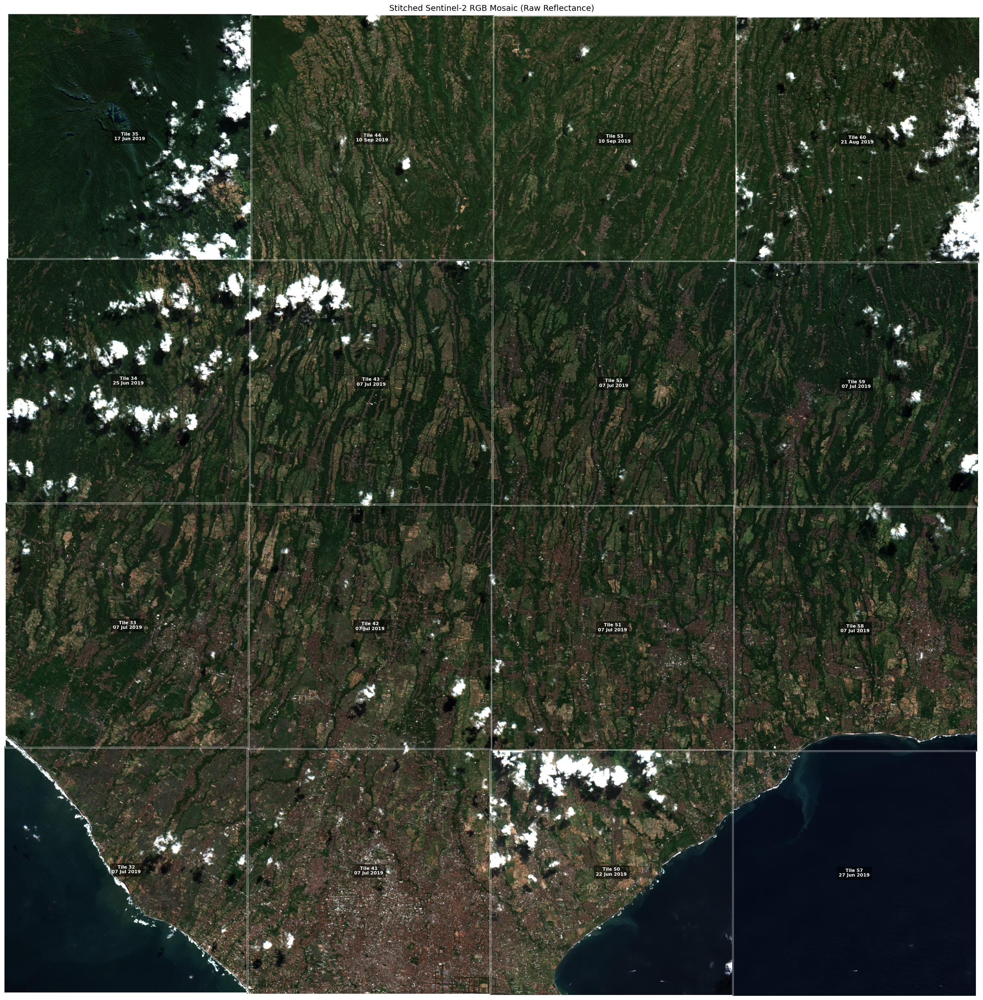

In [49]:
import os
import re
import numpy as np
import geopandas as gpd
from tifffile import imread
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from datetime import datetime

# ===========================
# 🔧 CONFIGURATION
# ===========================
TIMESTAMP_RE = re.compile(r"_(\d{8})T")
PATCH_PATH = "../data/patches/highlighted_patches.geojson"
RAW_FOLDER = "../data/raw/sentinel2"

# ===========================
# 📅 DATE RANGE FILTER
# ===========================
START_DATE = datetime.strptime("2019-06-01", "%Y-%m-%d")
END_DATE = datetime.strptime("2022-06-01", "%Y-%m-%d")

# ===========================
# 📦 PREPARE INPUTS
# ===========================
if not os.path.exists(PATCH_PATH):
    raise FileNotFoundError(f"Missing GeoJSON: {PATCH_PATH}")

gdf = gpd.read_file(PATCH_PATH)
patch_ids = gdf["patch_id"].tolist()

tile_images = []
tile_positions = []

# ===========================
# 🔁 Load RAW Images (Unnormalized)
# ===========================
print("\n🖼 Loading raw Sentinel-2 RGB tiles (no normalization)...")
for patch_id in patch_ids:
    tiff_candidates = sorted([
        f for f in os.listdir(RAW_FOLDER)
        if f.startswith(patch_id) and f.endswith(".tiff") and (
            (match := TIMESTAMP_RE.search(f)) and
            START_DATE <= datetime.strptime(match.group(1), "%Y%m%d") <= END_DATE
        )
    ])

    if not tiff_candidates:
        print(f"⚠️ {patch_id}: no candidates found.")
        continue

    accepted = False

    for filename in tiff_candidates:
        raw_tiff_path = os.path.join(RAW_FOLDER, filename)

        try:
            image = imread(raw_tiff_path)
            if image.ndim != 3 or image.shape[0] != 13:
                continue

            spectral = image[:12].astype(np.float32)
            rgb = np.transpose(spectral[[3, 2, 1]], (1, 2, 0))  # B04, B03, B02 (raw reflectance)

            # Normalize for display range [0, 1] using hard-coded reflectance scale (for visualization only)
            rgb_vis = rgb / 3000.0  # Sentinel-2 reflectance is usually scaled ~0–3000
            rgb_vis = np.clip(rgb_vis, 0, 1)

            # Quality filter: skip mostly dark/bright images
            black_fraction = np.mean(np.all(rgb_vis < 0.02, axis=-1))
            white_fraction = np.mean(np.all(rgb_vis > 0.98, axis=-1))

            if black_fraction > 0.05:
                print(f"🚫 {patch_id} ({filename}) black pixels: {black_fraction:.2%}")
                continue
            if white_fraction > 0.05:
                print(f"🚫 {patch_id} ({filename}) white pixels: {white_fraction:.2%}")
                continue

            geom = gdf.loc[gdf["patch_id"] == patch_id, "geometry"].values[0]
            minx, miny, maxx, maxy = geom.bounds

            tile_images.append(rgb_vis)
            tile_positions.append((minx, miny, maxx, maxy, patch_id, filename))

            print(f"✅ {patch_id} ({filename})")
            accepted = True
            break  # stop after first good image

        except Exception as e:
            print(f"⚠️ {patch_id} ({filename}): error - {e}")

    if not accepted:
        print(f"❌ {patch_id}: all images failed quality thresholds.")

# ===========================
# 🎩 VISUALIZE MOSAIC (RAW Reflectance)
# ===========================
fig, ax = plt.subplots(figsize=(24, 24))
all_x, all_y = [], []

for (minx, miny, maxx, maxy, patch_id, filename), rgb in zip(tile_positions, tile_images):
    extent = (minx, maxx, miny, maxy)
    ax.imshow(rgb, extent=extent, origin='upper')

    # Extract patch number
    patch_number_match = re.search(r"patch_(\d+)_", patch_id)
    patch_number = patch_number_match.group(1) if patch_number_match else patch_id

    # Extract and format date from filename
    timestamp_match = re.search(r"_(\d{8})T", filename)
    if timestamp_match:
        date_str = datetime.strptime(timestamp_match.group(1), "%Y%m%d").strftime("%d %b %Y")
    else:
        date_str = "Unknown"

    # Position label in the center
    center_x = (minx + maxx) / 2
    center_y = (miny + maxy) / 2

    label = f"Tile {int(patch_number)}\n{date_str}"
    ax.text(center_x, center_y, label,
            color='white', fontsize=8, weight='bold', ha='center', va='center',
            bbox=dict(facecolor='black', alpha=0.5, pad=3.0))

    ax.add_patch(Rectangle((minx, miny), maxx - minx, maxy - miny,
                           edgecolor='white', facecolor='none', linewidth=0.5))

    all_x.extend([minx, maxx])
    all_y.extend([miny, maxy])

ax.set_xlim(min(all_x), max(all_x))
ax.set_ylim(min(all_y), max(all_y))
ax.set_title("Stitched Sentinel-2 RGB Mosaic (Raw Reflectance)", fontsize=14)
ax.axis("off")
plt.tight_layout()
plt.show()


In [47]:
from collections import defaultdict

latest_dates = defaultdict(lambda: datetime(1900, 1, 1))

for patch_id in patch_ids:
    json_candidates = [f for f in os.listdir(s2_folder) if f.startswith(patch_id) and f.endswith(".json")]

    for json_file in json_candidates:
        json_path = os.path.join(s2_folder, json_file)
        try:
            with open(json_path, "r") as f:
                meta = json.load(f)
                timestamp = meta.get("timestamp", "")
                if timestamp:
                    dt = datetime.strptime(timestamp[:10], "%Y-%m-%d")
                    if dt > latest_dates[patch_id]:
                        latest_dates[patch_id] = dt
        except Exception as e:
            print(f"⚠️ Failed to read {json_path}: {e}")

# --- Print summary ---
print("\n📅 Latest available Sentinel-2 date per patch:")
for patch_id in sorted(latest_dates.keys()):
    print(f"  • {patch_id}: {latest_dates[patch_id].date()}")


NameError: name 's2_folder' is not defined

In [48]:
patch = "patch_00044_4359be37"
candidates = [f for f in os.listdir(s2_folder) if f.startswith(patch) and f.endswith(".json")]
print(f"\n📦 {patch} candidates:")
for f in sorted(candidates):
    print(f"  - {f}")

NameError: name 's2_folder' is not defined